In [1]:
from ecmwf.opendata import Client

client = Client(source="ecmwf")

client.retrieve(
    time=0,
    type="fc",
    step=24,
    param=["2t"],
    target="data.grib2",
)

By downloading data from the ECMWF open data dataset, you agree to the terms: Attribution 4.0 International (CC BY 4.0). Please attribute ECMWF when downloading this data.


Ignoring index file 'data.grib2.5b7b6.idx' older than GRIB file


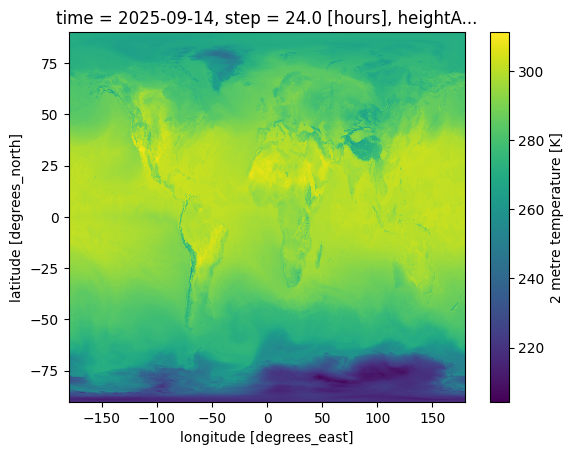

In [2]:
import xarray as xr

da = xr.load_dataarray("data.grib2", engine="cfgrib", decode_timedelta=False)
da.plot()

In [3]:
import requests
import zipfile
import io
import shapely

resp = requests.get("https://geodata.ucdavis.edu/gadm/gadm4.1/json/gadm41_BRA_2.json.zip")

with zipfile.ZipFile(io.BytesIO(resp.content)) as z:
    with z.open("gadm41_BRA_2.json") as f:
        geometry = shapely.from_geojson(f.read())

shapes = shapely.get_parts(geometry)

In [4]:
geometry

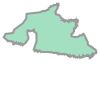

In [5]:
shapes[2]

In [16]:
from geomask import GeoMask

mask = GeoMask(shapes[2], 0.25)
mask

GeoMask(area=0.33, resolution=0.250, points=7, grid_type='regular_ll', offset=None, limit=None)

(<Figure size 1000x800 with 1 Axes>,
 <Axes: title={'center': 'GeoMask: 7 points (resolution=0.250)'}, xlabel='X', ylabel='Y'>)

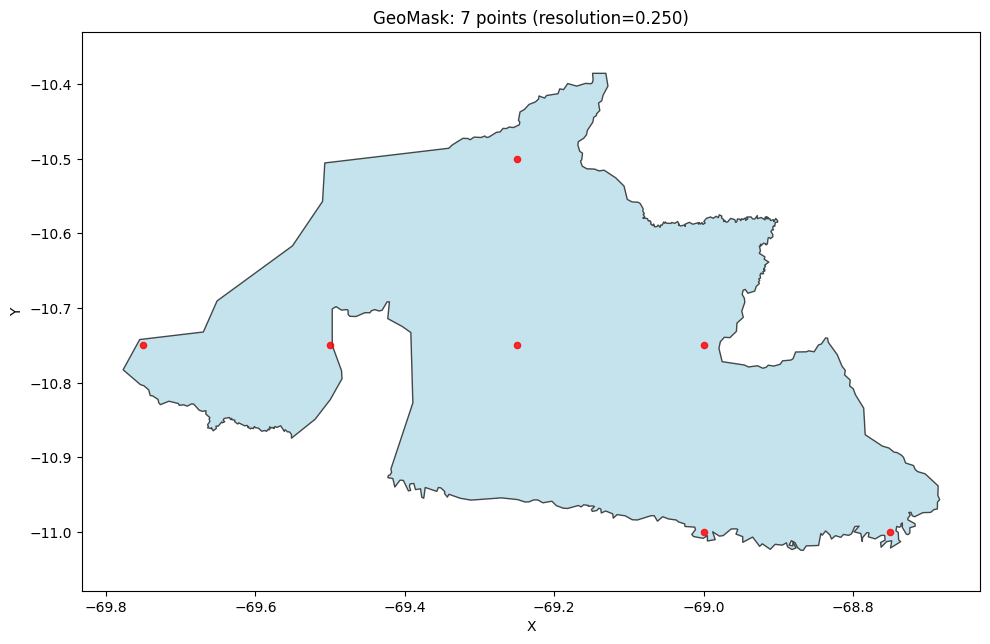

In [17]:
mask.plot()

In [18]:
mask_ds = mask.to_xarray("longitude", "latitude")
mask_ds

<xarray.Dataset> Size: 168B
Dimensions:    (index: 7)
Coordinates:
  * index      (index) int64 56B 0 1 2 3 4 5 6
Data variables:
    longitude  (index) float64 56B -69.75 -69.5 -69.25 -69.25 -69.0 -69.0 -68.75
    latitude   (index) float64 56B -10.75 -10.75 -10.75 -10.5 -11.0 -10.75 -11.0
Attributes:
    geomask_version:  0.1.1
    grid_type:        regular_ll
    area:             0.32783582500000064
    resolution:       0.25
    point_count:      7
    bounds:           (-69.7779, -11.0237, -68.6847, -10.385)
    offset:           None
    limit:            None

In [28]:
da.interp(GeoMask(shapes[101], 0.01).to_xarray("longitude", "latitude")).mean("index")

<xarray.DataArray 't2m' ()> Size: 8B
array(296.6712365)
Coordinates:
    time               datetime64[ns] 8B 2025-09-14
    step               float64 8B 24.0
    heightAboveGround  float64 8B 2.0
    valid_time         datetime64[ns] 8B 2025-09-15